In [1]:
%matplotlib inline
import torch
import torch.nn as nn
from torch.nn import DataParallel
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import copy
import pandas as pd
import cv2
import torch.utils.data as data
from glob import glob
from random import shuffle
from PIL import Image
from skimage.io import imread
from tqdm import tqdm

plt.ion()   # interactive mode

In [5]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
data_list = glob("/data/yuyue/rose/2018_origin/2018rose_origin/*")
data_list_1 = data_list[41:60]
for i in tqdm(data_list_1):
    folder_name = i.split("/")[-1] 
    dir_path = "/data/yuyue/rose/2018_origin/2018origin_224/"+ str(folder_name)
    os.popen("mkdir "+dir_path)
    
    for j in glob(i+"/*.jpg"):
        img = imread(j)
        img = Image.fromarray(img)
        img = img.resize((224,224),Image.BILINEAR)
        save_path = "/data/yuyue/rose/2018_origin/2018origin_224/"+str(folder_name)+"/"+j.split("/")[-1]
        img.save(save_path)
        


100%|██████████| 19/19 [1:09:14<00:00, 195.48s/it]


(224, 224, 3)

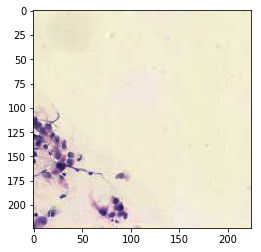

In [31]:
# gamma
from skimage import exposure
img = imread('/data/yuyue/rose/2018tumor_224/0/Tile000213.jpg')
gamma_img = exposure.adjust_gamma(img, 2)

plt.imshow(gamma_img)

gamma_img.shape


In [28]:
data_list = glob("/data/yuyue/rose/2018benign/*")
index = 0
for i in tqdm(data_list):
    dir_path = "/data/yuyue/rose/2018benign_224/"+ str(index)
    os.popen("mkdir "+dir_path)

    for j in glob(i+"/*.jpg"):
        img = imread(j)
        img = Image.fromarray(img)
        img = img.resize((224,224),Image.BILINEAR)
        save_path = "/data/yuyue/rose/2018benign_224/"+str(index)+"/"+j.split("/")[-1]
        img.save(save_path)
        
    index += 1




  0%|          | 0/54 [00:00<?, ?it/s]


  2%|▏         | 1/54 [01:50<1:37:13, 110.07s/it]


  4%|▎         | 2/54 [03:57<1:39:45, 115.11s/it]


  6%|▌         | 3/54 [06:56<1:54:20, 134.52s/it]


  7%|▋         | 4/54 [08:14<1:37:57, 117.55s/it]


  9%|▉         | 5/54 [10:17<1:37:22, 119.23s/it]


 11%|█         | 6/54 [12:48<1:43:00, 128.76s/it]


 13%|█▎        | 7/54 [13:25<1:19:12, 101.11s/it]


 15%|█▍        | 8/54 [15:29<1:22:42, 107.88s/it]


 17%|█▋        | 9/54 [19:07<1:45:48, 141.07s/it]


 19%|█▊        | 10/54 [22:05<1:51:34, 152.14s/it]


 20%|██        | 11/54 [23:15<1:31:20, 127.44s/it]


 22%|██▏       | 12/54 [24:37<1:19:37, 113.75s/it]


 24%|██▍       | 13/54 [26:16<1:14:44, 109.38s/it]


 26%|██▌       | 14/54 [28:15<1:14:55, 112.39s/it]


 28%|██▊       | 15/54 [30:35<1:18:16, 120.42s/it]


 30%|██▉       | 16/54 [31:47<1:07:04, 105.90s/it]


 31%|███▏      | 17/54 [34:31<1:16:04, 123.35s/it]


 33%|███▎      | 18/54 [35:55<1:07:03, 111.78s/it]


 35%|███▌  

In [8]:
df = pd.read_csv("/data/yuyue/rose/2018_origin/2018rose_annotation.csv")
df

,Unnamed: 0,name,old,new,label,mark
0,175,2018122906_1_11_CGRE_N,f7c1e68dff98c689985f35a709154662bedd6a0c,c8851fa2637f63223a95616fa4e7a5931f5cfd3a,-1,NaN
1,111,2018122905_3_25_JYSH_P,157839b94778eb7636eab26e02c5a9435ea89ade,94677bbb3c7fe875d158b5328fe7e53c7b8ef1e7,-1,NaN
2,26,2018122905_2_25_JYSH_N,3afe3d0951db30f0c6c5cae761a638b7d6eff2b8,46694c619559ff6225d6b6e946874eb6fa6d3a28,0,NaN
3,72,2018122905_1_25_JYSH_P,64fd3d38639cb940085caafedf745b6760fd2711,e8f4367e3b3bea07c42ea458b333369dc5376fc3,-1,NaN
4,166,2018122904_1_26_XYHU_N,eac2191c63de53280f0f29928a5f4ce110ea0656,bf4ac7c40908ee8bf4d29341137be52465ac1083,0,NaN
5,12,2018122903_1_11_SRQI_P,1c2f39ca510a19fbc9742f7482b63b0d41477145,12cd509865620d40acf597c759303df947002fa7,2,NaN
6,156,2018122902_3_15_JJJU_N,dcadab973bd39c2c159f1b9f7e134ab5fd3d78bb,080eb7469ae440ba7e09dcef22f9af014c76eb94,-1,NaN
7,164,2018122902_2_15_JJJU_N,e4746eafdcda4c4cbcf216ef2ce2bea81f9f063d,a869764273886693e4184c7acbbd0b98f4c0ade3,-1,NaN
8,31,2018122902_1_15_JJJU_N,4b65b7da0c50e27dd6ce4aac763c3a4af4875a37,e4b24230f2b510bc8de784565e9dd78b403cdfac,-1,NaN
9,163,2018122901_1_13_HYQI_P,e698d8d72df930b71448b19356998fcfb23037f9,0536e98e59d7ca68542afa3d67588e7de014ab7a,3,NaN


In [4]:
data_list = glob("/data/yuyue/rose/2018_origin/2018origin_224/*")

In [5]:
data_list[0]

'/data/yuyue/rose/2018_origin/2018origin_224/f195f4ede2eba08d6669458cfe85810658873fdb'

In [9]:
list(df.label[df.new == "f195f4ede2eba08d6669458cfe85810658873fdb"])[0]

2

In [13]:
data = {}
data_patch = []
data_target =[]
data_slide = []
data_list = glob("/data/yuyue/rose/2018_origin/2018origin_224/*")
for i in data_list[0:30]:
    folder_name = i.split("/")[-1]
    label = list(df.label[df.new == folder_name])[0]
    if label > 0:
        data_patch.append(glob(i+"/*.jpg"))
        data_target.append(1)
        data_slide.append(i)
    elif label == 0:
        data_patch.append(glob(i+"/*.jpg"))
        data_target.append(0)
        data_slide.append(i)
    
data["patch"] = data_patch
data["targets"] = data_target
data["slides"] = data_slide

torch.save(data,"/home/yuyue/yuyue/rose/2018data_train.pth")

In [11]:
data = torch.load("data_val.pth")

In [5]:
data.keys()

['slides', 'targets', 'patch']

In [4]:
data["patch"]

[['/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000663.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000566.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000873.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000364.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000004.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000442.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000012.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000334.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000516.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5805270f14/000467.jpg',
  '/data/tlc/TCT/all_data/20190717_224/804ec0a5b01bf270bf343696063d8f5

In [8]:
import pandas as pd

In [10]:
df = pd.DataFrame(a) 

In [11]:
df.to_csv("/data/yuyue/rose/result/convergence.csv")

In [13]:
len(data['patch'])

53

In [12]:
len(data['slides'])

53